# Машинное обучение, ФКН ВШЭ

# Практическое задание 10. Обучение без учителя.

## Общая информация
Дата выдачи: 26.03.2025

Мягкий дедлайн: 13.04.2025 23:59 MSK

Жёсткий дедлайн: 17.04.2025 23:59 MSK

## Оценивание и штрафы

Каждая из задач имеет определенную «стоимость» (указана в скобках около задачи).

Сдавать задание после указанного срока сдачи нельзя.

Задание выполняется самостоятельно. «Похожие» решения считаются плагиатом и все задействованные студенты (в том числе те, у кого списали) не могут получить за него больше 0 баллов (подробнее о плагиате см. на странице курса). Если вы нашли решение какого-то из заданий (или его часть) в открытом источнике, необходимо указать ссылку на этот источник в отдельном блоке в конце вашей работы (скорее всего вы будете не единственным, кто это нашел, поэтому чтобы исключить подозрение в плагиате, необходима ссылка на источник).

Неэффективная реализация кода может негативно отразиться на оценке.

## Формат сдачи
Задания сдаются через систему anytask. Посылка должна содержать:
* Ноутбук homework-practice-10-Username.ipynb

Username — ваша фамилия на латинице

## О задании

В этом задании мы посмотрим на несколько алгоритмов кластеризации и применим их к географическим и текстовым данным. Также мы подробно остановимся на тематическом моделировании текстов, задаче обучения представлений и в каком-то смысле поработаем с semi-supervised learning.



In [ ]:
import pandas as pd
import numpy as np

np.random.seed(0xFFFFFFF)

**Задание 0 (1e-100 балла)**. Опишите свои ощущения от домашки по ЕМ-алгоритму (можно картинкой или мемом).

In [ ]:
print('плаки-плаки')

плаки-плаки


## Часть 1. Кластеризация автобусных остановок

В этом задании мы сравним разные алгоритмы кластеризации для данных об автобусных остановках Москвы.

**Задание 1.1 (1 балл).** Реализуйте алгоритм спектральной кластеризации, который упоминался на лекции. Для этого разберитесь с кодом шаблона, данного ниже, и допишите недостающую функцию. Напомним, что для графа с матрицей смежности $W = \{w_{ij}\}_{i, j = 1 \dots \ell}$ лапласиан определяется как:

$$
L = D - W,
$$

где $D = \text{diag}(d_1, ..., d_{\ell}), d_i = \sum_{j=1}^{\ell} w_{ij}$.

In [ ]:
from sklearn.base import ClusterMixin
from sklearn.cluster import KMeans


class GraphClustering(ClusterMixin):
    def __init__(self, n_clusters=8, n_components=None, **kwargs):
        '''
        Spectral clustering algorithm
        param n_clusters: number of clusters to form
        param n_components: number of eigenvectors to use
        '''

        if n_components is None:
            n_components = n_clusters

        self.n_components = n_components
        self.kmeans = KMeans(n_clusters=n_clusters, **kwargs)

    def fit_predict(self, X, y=None):
        '''
        Perform spectral clustering from graph adjacency matrix
        and return vertex labels.
        param X: (n_samples, n_samples) - graph adjacency matrix
        return: (n_samples, ) - vertex labels
        '''

        eigenvectors = self._generate_eigenvectors(X)
        labels = self.kmeans.fit_predict(eigenvectors[:, 1:])
        return labels

    def _generate_eigenvectors(self, X):
        '''
        Compute eigenvectors for spectral clustering
        param X: (n_samples, n_samples) - graph adjacency matrix
        return: (n_samples, n_components) - eigenvectors
        '''
        d = np.sum(X, axis=1)
        D = np.diag(d)
        L = D - X

        eigenvalues, eigenvectors = np.linalg.eigh(L) # находим собственные значения и векторы

        # выбираем n_components наименьших собственных значений
        indexes = np.argsort(eigenvalues)[:self.n_components]
        min_eigenvectors = eigenvectors[:, indexes]

        return min_eigenvectors.real

Перед тем, как переходить к следующему заданию, протестируйте свое решение.

In [ ]:
n_blocks, n_vertices = 10, 1000
block_vertices = n_vertices // n_blocks

X = np.zeros((n_vertices, n_vertices))
for i in range(0, n_vertices, block_vertices):
    X[i:i + block_vertices, i:i + block_vertices] = np.sqrt(i + 1)

graph_clustering = GraphClustering(n_clusters=n_blocks)
labels = graph_clustering.fit_predict(X)

true_labels = np.zeros(n_vertices, dtype=np.int32)
for i in range(0, n_vertices, block_vertices):
    true_labels[i:i + block_vertices] = labels[i]

assert labels.shape == (n_vertices, )
assert np.all(np.bincount(labels) == np.full(n_blocks, block_vertices))
assert np.all(labels == true_labels)

Теперь можем приступить к работе с реальными данными. Скачайте файл с данными об остановках общественного транспорта **в формате .xlsx** по [ссылке](https://data.mos.ru/opendata/download/60464/1/201) (так гарантированно не возникнет проблем с парсингом файла) и загрузите таблицу в ноутбук. Альтернативная ссылка: [отсюда](https://disk.yandex.ru/i/J0HlcDXd_KyIeg). Для удобства визуализации мы будем работать только с остановками в ЦАО.

In [ ]:
data = pd.read_excel('transport.xlsx')
data = data[data.AdmArea_en == "Czentral`ny'j administrativny'j okrug"]
data = data.reset_index()
data.head()

,index,ID_en,Name_en,Longitude_WGS84_en,Latitude_WGS84_en,Street_en,AdmArea_en,District_en,RouteNumbers_en,StationName_en,Direction_en,Pavilion_en,OperatingOrgName_en,EntryState_en,global_id,geoData
0,278,347,"«2-й Лесной пер.», улица Бутырский Вал (347)",37.586584,55.782106,улица Бутырский Вал,Czentral`ny'j administrativny'j okrug,Tverskoj rajon,АТ18; А12; АТ56; АТ78,2-й Лесной пер.,NaN,да,ГУП «Мосгортранс»,active,889085436,NaN
1,279,349,"«Ул. Сущевский Вал», Новослободская улица (349)",37.590714,55.790630,Новослободская улица,Czentral`ny'j administrativny'j okrug,Tverskoj rajon,АТ47; АМ10; АТ3; АТ56; АТ78,Ул. Сущевский Вал,NaN,да,ГУП «Мосгортранс»,active,889085437,NaN
2,355,479,"«Стадион Лужники (южн.) (пос.)», улица Лужники...",37.565972,55.714265,улица Лужники,Czentral`ny'j administrativny'j okrug,rajon Xamovniki,А64; А216; А809; АС12; А255; АБК; АТ79,Стадион Лужники (южн.) (пос.),NaN,да,ГУП «Мосгортранс»,active,889085549,NaN
3,356,480,"«Спортзал Дружба», Лужнецкая набережная (480)",37.570191,55.712504,Лужнецкая набережная,Czentral`ny'j administrativny'j okrug,rajon Xamovniki,А64; А216; А809; АС12; А255; АБК; АТ79,Спортзал Дружба,NaN,да,ГУП «Мосгортранс»,active,889085550,NaN
4,357,481,"«Лужнецкая наб.», Лужнецкая набережная (481)",37.574559,55.713770,Лужнецкая набережная,Czentral`ny'j administrativny'j okrug,rajon Xamovniki,А64; А216; А809; АС12; А255; АБК; АТ79,Лужнецкая наб.,NaN,да,ГУП «Мосгортранс»,active,889085551,NaN


Воспользуемся библиотекой `folium` для визуализации данных.

In [ ]:
import folium

map = folium.Map([55.75215, 37.61819], zoom_start=12)
for id, row in data.iterrows():
    folium.Circle([row.Latitude_WGS84_en, row.Longitude_WGS84_en],
                  radius=10).add_to(map)
map

**Задание 1.2 (1 балл).** Попробуем построить граф, в котором вершинами будут остановки. Как вы уже могли заметить, для каждой остановки указаны номера маршрутов, проходящих через неё. Логично соединить ребрами соседние остановки каждого маршрута. Однако мы не знаем, в каком порядке автобусы объезжают остановки. Но мы можем применить эвристический алгоритм, который восстановит нам порядок маршрутов:

* Для каждого маршрута выделим список всех остановок, через которые он проходит.
* Выберем начальную остановку маршрута как точку, наиболее удаленную от всех остальных остановок этого маршрута.
* Каждую следующую точку маршрута будем выбирать как самую близкую из оставшихся точек (не включенных в маршрут ранее).

Фактически, у нас получается жадное решение задачи коммивояжера. Когда мы отсортировали маршруты, можем построить по ним граф. Будем строить его по таким правилам:

* Между двумя остановками будет ребро, если они являются соседними хотя бы на одном маршруте. Вес ребра равен числу маршрутов, на которых остановки являются соседними.
* В графе не будет петель (то есть у матрицы смежности будет нулевая диагональ).

Реализуйте предложенный способ построения графа. Для этого рекомендуется воспользоваться шаблонами, приведенными ниже.

In [ ]:
from scipy.spatial import distance

def get_routes(data):
    '''
    Accumulate routes from raw data
    param data: pd.DataFrame - public transport stops data
    return: dict - unsorted stops ids for each route,
                   e.g. routes['A1'] = [356, 641, 190]
    '''
    data['RouteNumbers'] = data['RouteNumbers_en'].str.split('; ')
    exploded = data.explode('RouteNumbers')
    grouped = exploded.groupby('RouteNumbers').groups
    return {route: list(indexes) for route, indexes in grouped.items()}

def sort_routes(data, routes):
    '''
    Sort routes according to the proposed algorithm
    param data: pd.DataFrame - public transport stops data
    param routes: dict - unsorted stops ids for each route
    return: dict - sorted stops ids for each route
    '''
    sorted_routes = dict()
    for route in routes.keys():
        sorted_stops = []
        remaining_indexes = set(range(len(routes[route])))

        # считаем эвлкидово расстояние по двум координатам
        route_stops = data.loc[routes[route], ['Longitude_WGS84_en', 'Latitude_WGS84_en']]
        distance_matrix = distance.cdist(route_stops, route_stops, metric='euclidean')

        # определяем начальную  остановку
        init_stop_index = np.argmax(np.sum(distance_matrix, axis=0))
        sorted_stops.append(int(init_stop_index))
        remaining_indexes.remove(init_stop_index)

        # выбираем самую близкую остановку из оставшихся относительно последней
        while remaining_indexes:
            last_stop = sorted_stops[-1]
            closest_index = min(remaining_indexes, key=lambda x: distance_matrix[last_stop, x])
            sorted_stops.append(closest_index)
            remaining_indexes.remove(closest_index)
        sorted_routes[route] = [routes[route][j] for j in sorted_stops]

    return sorted_routes

def get_adjacency_matrix(data, sorted_routes):
    '''
    Compute adjacency matrix for sorted routes
    param data: pd.DataFrame - public transport stops data
    param sorted_routes: dict - sorted stops ids for each route
    return: (n_samples, n_samples) - graph adjacency matrix
    '''
    adjacency_matrix = np.zeros((len(data), len(data)))

    # заполняем матрицу смежности, учитывая симметрию
    for route in sorted_routes.keys():
        for i in range(len(sorted_routes[route])-1):
            adjacency_matrix[sorted_routes[route][i], sorted_routes[route][i+1]] += 1
            adjacency_matrix[sorted_routes[route][i+1], sorted_routes[route][i]] += 1
    return adjacency_matrix

In [ ]:
routes = get_routes(data)
sorted_routes = sort_routes(data, routes)
adjacency_matrix = get_adjacency_matrix(data, sorted_routes)

Проверим, что маршруты получились адекватными. Для этого нарисуем их на карте.

In [ ]:
map = folium.Map([55.75215, 37.61819], zoom_start=12)
for route_id in np.random.choice(list(sorted_routes.keys()), size=5):
    coords = data.loc[
        sorted_routes[route_id],
        ['Latitude_WGS84_en', 'Longitude_WGS84_en']
    ].values.tolist()
    folium.vector_layers.PolyLine(coords).add_to(map)

map

**Задание 1.3 (0 баллов)**. Реализуйте функцию `draw_clustered_map`, которая рисует карту центра Москвы с кластерами остановок, раскрашенными в разные цвета.

In [ ]:
import random
def draw_clustered_map(data, labels):
    '''
    Create map with coloured clusters
    param data: pd.DataFrame - public transport stops data
    param labels: (n_samples, ) - cluster labels for each stop
    return: folium.Map - map with coloured clusters
    '''
    colors = ["#"+''.join([random.choice('0123456789ABCDEF') for _ in range(6)]) for _ in range(100)]
    colors.append('white') # этим цветом будут раскрашиваться выбросы
    map = folium.Map([55.75215, 37.61819], zoom_start=12)
    for id, row in data.iterrows():
        folium.Circle([row.Latitude_WGS84_en, row.Longitude_WGS84_en],
                      radius=10, color=colors[labels[id]]).add_to(map)
    return map

**Задание 1.4 (1.5 балла)**. Примените алгоритмы кластеризации и подберите гиперпараметры так, чтобы кластеры получились осмысленными (нет такого, что все принадлежит одному кластеру или большая часть точек это шум):
- `sklearn.clustering.KMeans` - `n_clusters`
- `sklearn.clustering.DBSCAN` - `eps`
- ваш `SpectralClustering` - `n_clusters` и `n_components`

Для ряда алгоритмов, в частности DBSCAN, подобрать оптимальные параметры может быть ой, как непросто. Чтобы помочь сохранить нервные клетки рекомендуется пользоваться метриками Intrinsic Evaluation для кластеризации. Для каждого алгоритма скорее всего придется брать разные метрики, а может быть оптимизировать сразу несколько.

Ваша задача - выбрать подходящую метрику, можно взять что-то из списка ниже, можно спросить у гугла. Применить GridSearch, `optuna` или `hyperopt` и желательно завернуть отбор параметров в функцию, пригодится далее

1. $
   \text{Calinski-Harabasz Index} \in [0, \inf] = \frac{\sum_{i=1}^k BCSS_i/(k-1)}{\sum_{i=1}^k WCSS_i/(n-k)} = \frac{\sum_{i=1}^k n_i \| \mathbf{c}_i - \mathbf{c} \|^2/(k-1)}{\sum_{i=1}^k \sum_{\mathbf{x} \in C_i} \|\mathbf{x} - \mathbf{c}_i\|^2/(n-k)} \rightarrow max
   $
   - Отношение 1) расстояния от центра кластера до центра всех данных к 2) расстоянию от центра кластера до точки
   - Чем однороднее и дальше друг от друга кластеры, тем лучше
2. $
   \text{Silhouette Score} \in [0, 1] = \sum_i \frac{b_i - a_i}{\max(a_i, b_i)} \rightarrow max
   $
   - $a_i$ - среднее расстояние до точек внутри своего кластера
   - $b_i$ - среднее расстояние до точек из ближайшего кластера
   - Если в своем кластере точки близко - кластер плотный, идеальный вариант, скор равен 1, если свой кластер совпадает с соседним - кластеры неразделимы, скор равен нулю
   - Чем однороднее и разделимее кластеры, тем лучше
3. $\text{Davies-Bouldin Index} \in [0, inf] = \frac{1}{k} \sum_{i=1}^{k} \max_{j \neq i} \left( \frac{WCSS_i + WCSS_j}{d(c_i, c_j)} \right) \rightarrow min $
   - Отношение внутрикластерных расстояний к межкластерному расстоянию между двумя центрами
   - Если кластеры далеко друг от друга, но при этом однородные, скор наименьший
3. $\text{Elbow Method}$ - последовательное сравнение $WCSS$ из пункта 1 для разного числа параметров. Если уменьшение меньше определенного порога - останавливаемся, считаем это значение оптимальным

Визуализируйте результат кластеризации с помощью функции `draw_clustered_map`.

**Спасибо за рекомендацию, но в данном случае я смог подобрать гиперпараметры вручную, в следующих заданиях использовал optuna.**

In [ ]:
from sklearn.cluster import KMeans, DBSCAN

kmeans = KMeans(n_clusters=8).fit(data[['Longitude_WGS84_en', 'Latitude_WGS84_en']])
draw_clustered_map(data, kmeans.labels_)

In [ ]:
from sklearn.cluster import KMeans, DBSCAN

dbscan = DBSCAN(eps=0.00375).fit(data[['Longitude_WGS84_en', 'Latitude_WGS84_en']])
draw_clustered_map(data, dbscan.labels_)

In [ ]:
graph_clustering = GraphClustering(n_clusters=35, n_components=15)
labels = graph_clustering.fit_predict(adjacency_matrix)
draw_clustered_map(data, labels)

**Вопрос:** Чем отличаются разбиения на кластеры, получаемые разными алгоритмами? Какие плюсы и минусы есть у каждого алгоритма? Какой алгоритм кажется вам наиболее подходящим для кластеризации остановок?

**Ответ:** K-Means разбивает остановки на непересекающиеся кластеры, по форме они похожи на выпуклые многоугольники, плюс данного подхода в том, что очень легко подобрать гиперпараметр n_clusters, то есть алгоритм неприхотлив, минус в том, что все кластеры выпуклые, то есть форма маршрутов неучитывается.

DBSCAN разбивает остановки на пересекающиеся кластеры разной формы, то есть частично учитывается форма маршрутов, что является плюсом данного алгоритма, а также алгоритм выделяет шумовые точки, что может быть полезно. Минус в том, что очень трудно подобрать гиперпараметр eps, при небольших отклонениях от оптимального значения алгоритм выделяет все в один кластер.

SpectralClustering также разбивает остановки на пересекающиеся кластеры, но здесь наблюдается точное понимание алгоритма о форме маршрутов, что является важным плюсом. Также подобрать гиперпараметры намного легче, чем в DBSCAN, но сложнее, чем в K-Means, так как гиперпараметра два, а не один. Кроме того алгоритм не выделяет шумовые точки, в отличие от DBSCAN.

Учитывая все плюсы и минусы, я считаю, что для кластеризации остановок наиболее подходящим является алгоритм SpectralClustering.

## Часть 2. Тематическое моделирование текстов

В этой части мы познакомимся с одной из самых популярных задач обучения без учителя &mdash; с задачей тематического моделирования текстов. Допустим, нам доступна некоторая коллекция документов без разметки, и мы хотим автоматически выделить несколько тем, которые встречаются в документах, а также присвоить каждому документу одну (или несколько) тем. Фактически, мы будем решать задачу, похожую на кластеризацию текстов: отличие в том, что нас будет интересовать не только разбиение текстов на группы, но и выделение ключевых слов, определяющих каждую тему.

Мы будем работать с новостными статьями BBC за 2004-2005 годы. Скачайте данные по [ссылке](https://www.kaggle.com/hgultekin/bbcnewsarchive).

In [ ]:
data = pd.read_csv('bbc-news-data.csv', sep='\t')
data.sample(5)

,category,filename,title,content
72,business,073.txt,German growth goes into reverse,Germany's economy shrank 0.2% in the last thr...
451,business,452.txt,McDonald's boss Bell dies aged 44,"Charlie Bell, the straight-talking former hea..."
1759,sport,447.txt,Serena ends Sania Mirza's dream,"Sania Mirza, the first Indian woman to reach ..."
634,entertainment,125.txt,Snow Patrol feted at Irish awards,Snow Patrol were the big winners in Ireland's...
1022,politics,127.txt,Brown to outline presidency goals,"Next year will be ""make or break"" for develop..."


Как вы могли заметить, данные уже содержат разметку по тематике (колонка category). В этой части мы забудем, что она есть, и будем работать только с текстовыми данными. Проведем предобработку текста, состоящую из следующих пунктов:

* Объединим заголовок и содержание статьи в одно поле.
* Приведем текст к нижнему регистру, разобьем его на токены.
* Оставим только буквенные слова (удалив, таким образом, пунктуацию и числа).
* Применим лемматизацию.
* Удалим стоп-слова.


In [ ]:
import nltk
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
from nltk.stem import WordNetLemmatizer

In [ ]:
nltk.download('punkt')
nltk.download('wordnet')
nltk.download('stopwords')
nltk.download('punkt_tab')

stop_words = set(stopwords.words('english') + ['ha', 'wa', 'say', 'said'])
lemmatizer = WordNetLemmatizer()

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package punkt_tab to /root/nltk_data...
[nltk_data]   Package punkt_tab is already up-to-date!


In [ ]:
def preprocess(text):
    text = list(filter(str.isalpha, word_tokenize(text.lower())))
    text = list(lemmatizer.lemmatize(word) for word in text)
    text = list(word for word in text if word not in stop_words)
    return ' '.join(text)

In [ ]:
data['raw_text'] = data.apply(lambda row: row.title + row.content, axis=1)
data['text'] = data.apply(lambda row: preprocess(row.raw_text), axis=1)

Для визуализации частот слов в текстах мы будем использовать [облака тегов](https://en.wikipedia.org/wiki/Tag_cloud).

In [ ]:
from wordcloud import WordCloud

def draw_wordcloud(texts, max_words=1000, width=1000, height=500):
    wordcloud = WordCloud(background_color='white', max_words=max_words,
                          width=width, height=height)

    joint_texts = ' '.join(list(texts))
    wordcloud.generate(joint_texts)
    return wordcloud.to_image()

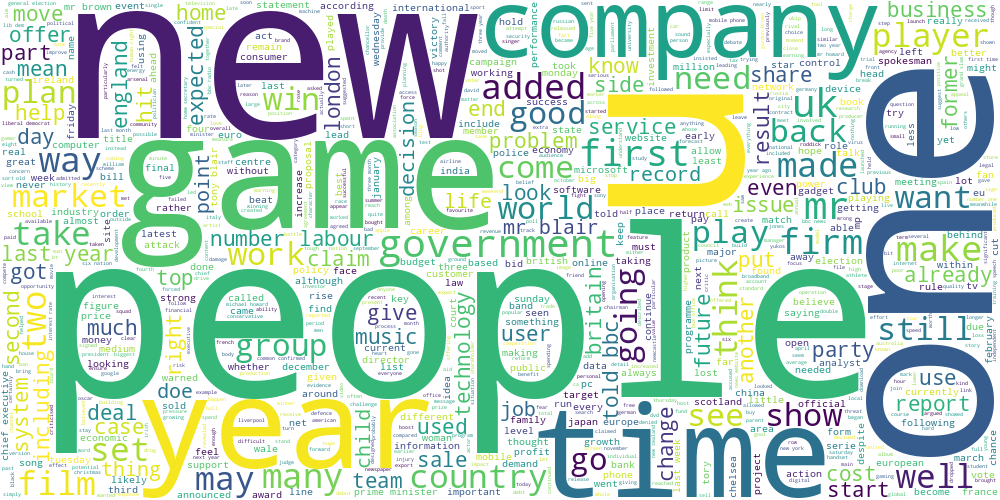

In [ ]:
draw_wordcloud(data.text)

**Задание 2.1 (1 балл).** Обучите алгоритм K-Means на tf-idf представлениях текстов. При обучении tf-idf векторайзера рекомендуется отбрасывать редко встречающиеся слова, а также воздержитесь от использования N-грамм. Возьмите не очень большое число кластеров, чтобы было удобно интерпретировать получившиеся темы (например, `n_clusters` = 8). Постройте облака тегов для текстов из разных кластеров.

In [ ]:
from sklearn.feature_extraction.text import TfidfVectorizer

vectorizer = TfidfVectorizer(min_df=0.1)
vectorized_texts = vectorizer.fit_transform(data.text)

In [ ]:
from sklearn.cluster import KMeans

kmeans = KMeans(n_clusters=8).fit(vectorized_texts)

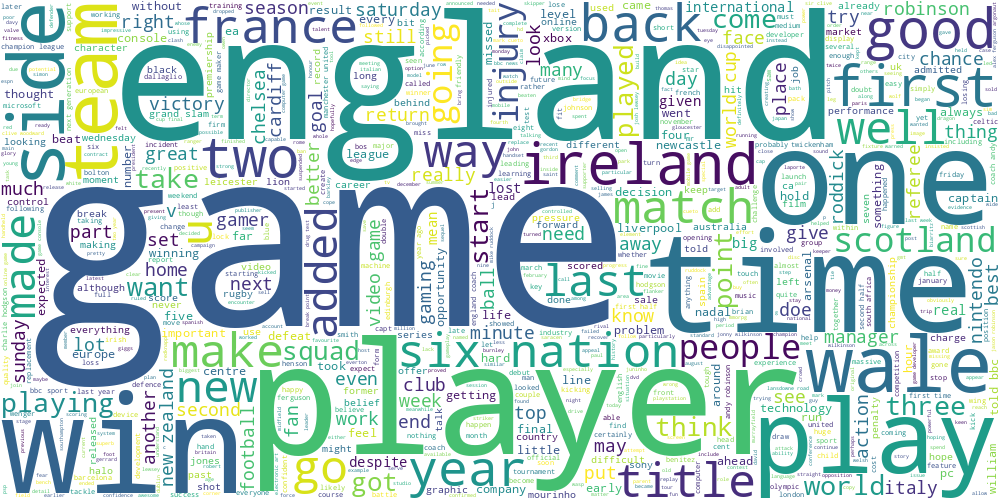

In [ ]:
draw_wordcloud(data[kmeans.labels_ == 0].text)

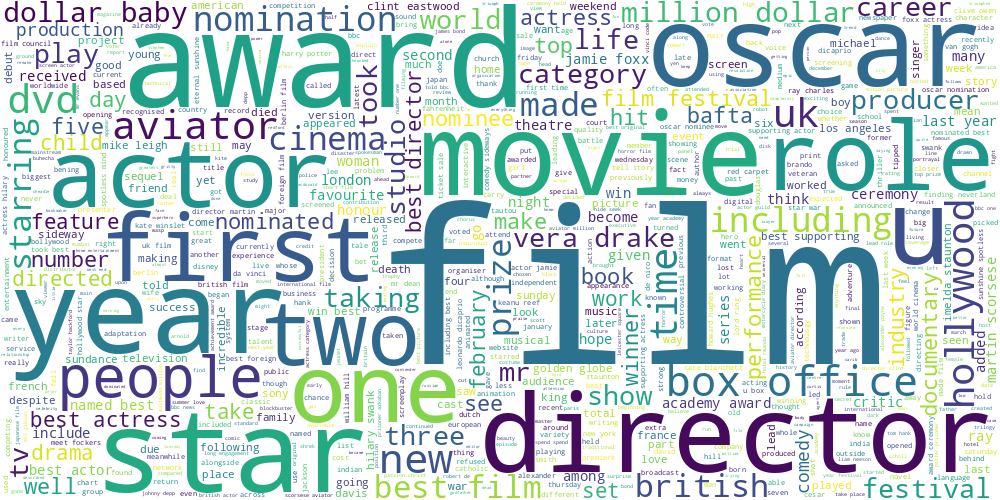

In [ ]:
draw_wordcloud(data[kmeans.labels_ == 1].text)

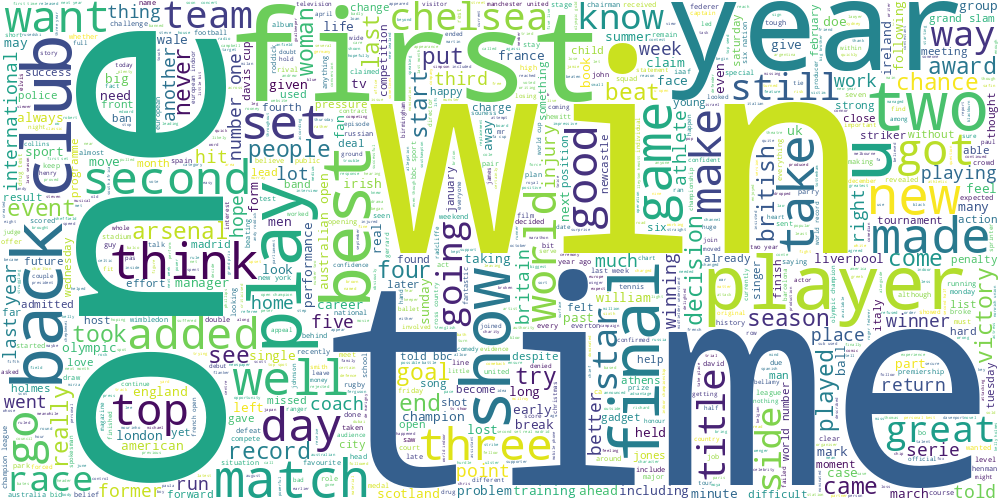

In [ ]:
draw_wordcloud(data[kmeans.labels_ == 2].text)

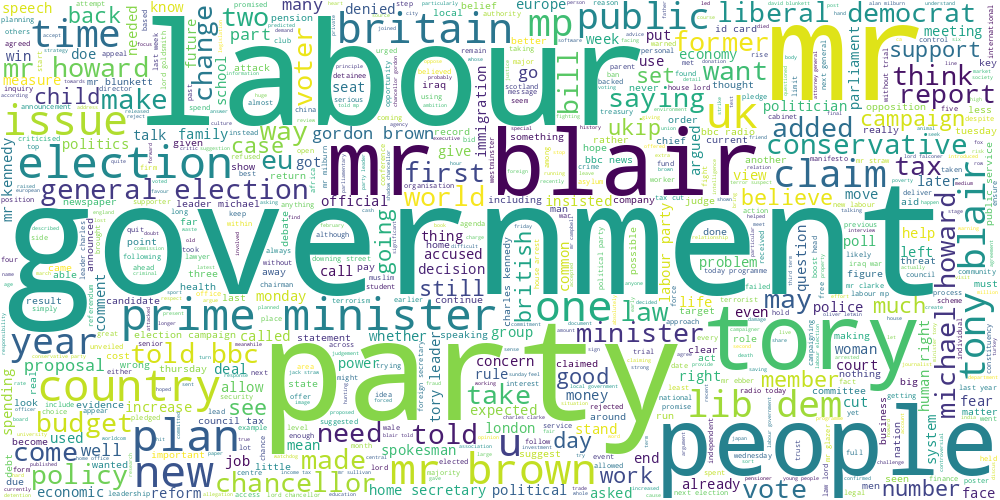

In [ ]:
draw_wordcloud(data[kmeans.labels_ == 3].text)

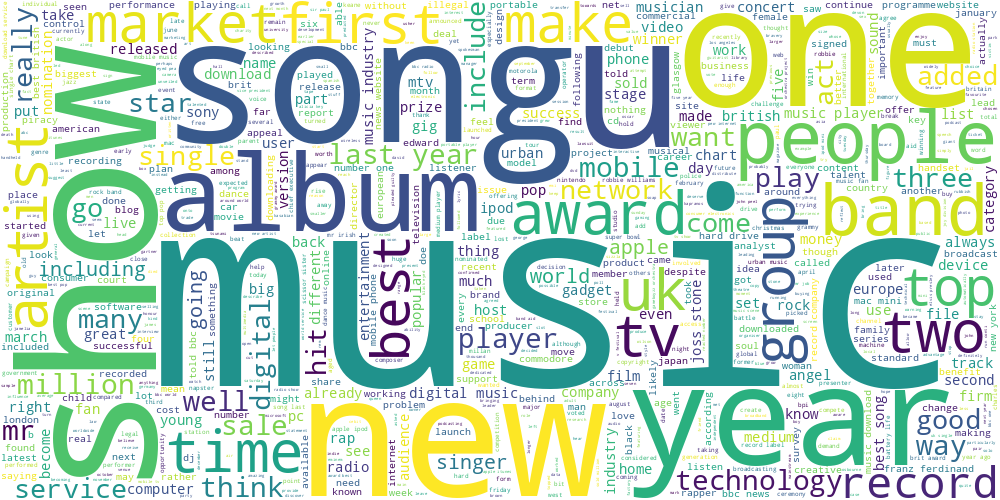

In [ ]:
draw_wordcloud(data[kmeans.labels_ == 4].text)

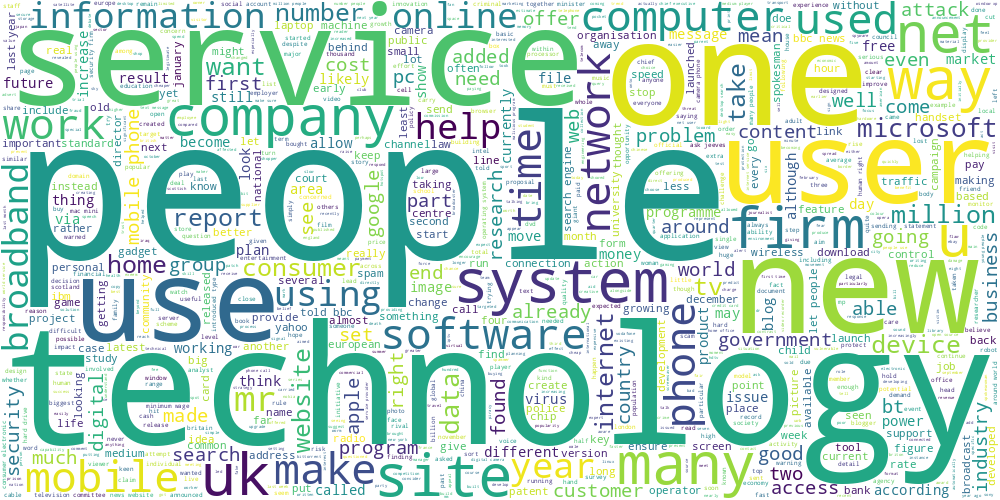

In [ ]:
draw_wordcloud(data[kmeans.labels_ == 5].text)

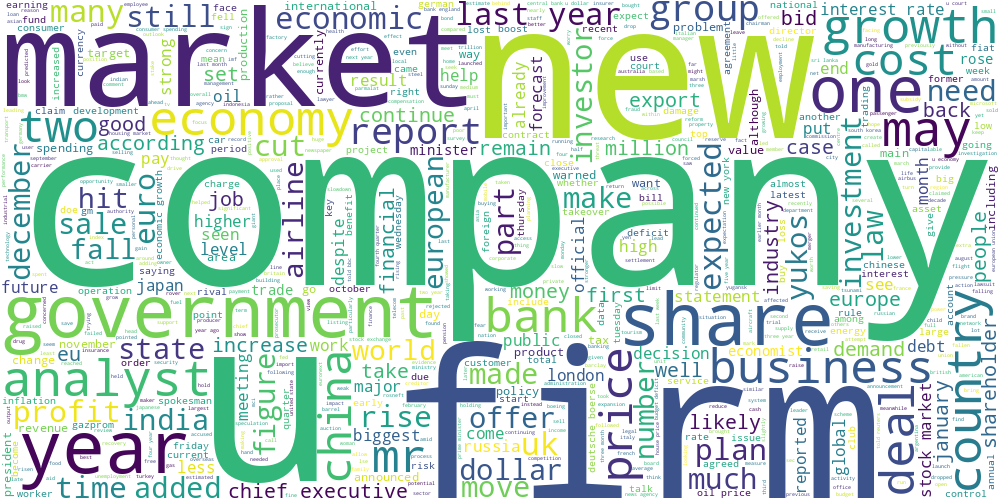

In [ ]:
draw_wordcloud(data[kmeans.labels_ == 6].text)

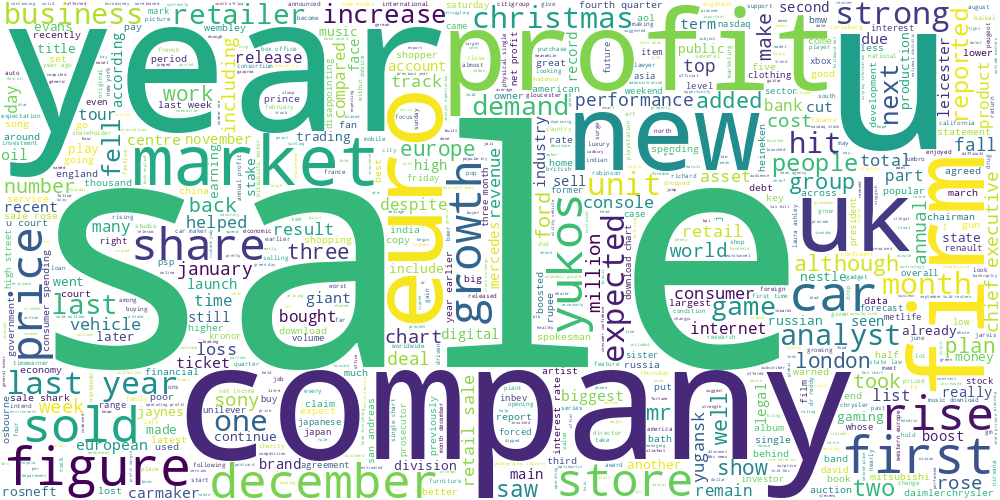

In [ ]:
draw_wordcloud(data[kmeans.labels_ == 7].text)

Получились ли темы интерпретируемыми? Попробуйте озаглавить каждую тему.

**Ответ:** Темы получились интерпретируемыми:

0 - футбол

1 - кино

2 - спорт

3 - политика

4 - музыка

5 - технологии

6 - бизнес

7 - экономика

**Задание 2.2 (0.5 балла).** Попробуем другой способ выделить ключевые слова для каждой темы. Помимо непосредственного разбиения объектов алгоритм K-Means получает центр каждого кластера. Попробуйте взять центры кластеров и посмотреть на слова, для которых значения соответствующих им признаков максимальны.

In [ ]:
vocab = vectorizer.get_feature_names_out()

for i, cluster in enumerate(kmeans.cluster_centers_):
    indexes = np.argsort(cluster)
    print(f'cluster {i}: {vocab[indexes][::-1][:10]}')

cluster 0: ['game' 'england' 'player' 'side' 'win' 'team' 'six' 'play' 'time' 'first']
cluster 1: ['film' 'best' 'star' 'director' 'year' 'also' 'office' 'including'
 'first' 'one']
cluster 2: ['year' 'world' 'win' 'first' 'player' 'final' 'open' 'second' 'last'
 'best']
cluster 3: ['mr' 'labour' 'election' 'party' 'would' 'government' 'minister' 'plan'
 'leader' 'people']
cluster 4: ['music' 'show' 'year' 'record' 'one' 'best' 'new' 'player' 'also' 'group']
cluster 5: ['people' 'service' 'technology' 'system' 'use' 'firm' 'could' 'used' 'mr'
 'many']
cluster 6: ['company' 'firm' 'market' 'year' 'share' 'price' 'growth' 'government'
 'analyst' 'new']
cluster 7: ['sale' 'year' 'company' 'firm' 'growth' 'share' 'last' 'new' 'market'
 'figure']


Согласуются ли полученные слова с облаками тегов из прошлого задания?

**Ответ:** полученные слова отлично согласуются с облаками тегов.

**Задание 2.3 (1.5 балла).** В первой части мы сравнили три разных алгоритма кластеризации на географических данных. Проделаем то же самое для текстовых данных (в качестве признакого описания снова используем tf-idf). Получите три разбиения на кластеры с помощью алгоритмов K-Means, DBSCAN и спектральной кластеризации (на этот раз воспользуйтесь реализацией из `sklearn`). Для K-Means и спектральной кластеризации возьмите одинаковое небольшое число кластеров, подберите параметр `eps` метода DBSCAN так, чтобы получить приблизительно такое же число кластеров (подумайте, как это можно сделать)

Далее, обучите двухмерные t-SNE представления над tf-idf признаками текстов. Визуализируйте эти представления для каждого алгоритма, раскрасив каждый кластер своим цветом. Лучше всего расположить визуализации на одном графике на трех разных сабплотах. Не забудьте, что DBSCAN помечает некоторые точки как шумовые (можно раскрасить их в отдельный цвет).

In [ ]:
from sklearn.cluster import KMeans, DBSCAN, SpectralClustering

kmeans = KMeans(n_clusters=8).fit(vectorized_texts)

spectral = SpectralClustering(n_clusters=8).fit(vectorized_texts)

In [ ]:
for eps in np.linspace(0.01, 1.0, 100):
    dbscan = DBSCAN(eps = eps).fit(vectorized_texts)
    if -1 in dbscan.labels_:
        n_clusters = len(np.unique(dbscan.labels_)) - 1
    else:
        n_clusters = len(np.unique(dbscan.labels_))

    print(f'eps: {round(eps, 2)}, n_clusters: {n_clusters}')

eps: 0.01, n_clusters: 0
eps: 0.02, n_clusters: 0
eps: 0.03, n_clusters: 0
eps: 0.04, n_clusters: 0
eps: 0.05, n_clusters: 0
eps: 0.06, n_clusters: 0
eps: 0.07, n_clusters: 0
eps: 0.08, n_clusters: 0
eps: 0.09, n_clusters: 0
eps: 0.1, n_clusters: 0
eps: 0.11, n_clusters: 0
eps: 0.12, n_clusters: 0
eps: 0.13, n_clusters: 0
eps: 0.14, n_clusters: 0
eps: 0.15, n_clusters: 0
eps: 0.16, n_clusters: 0
eps: 0.17, n_clusters: 0
eps: 0.18, n_clusters: 0
eps: 0.19, n_clusters: 0
eps: 0.2, n_clusters: 0
eps: 0.21, n_clusters: 0
eps: 0.22, n_clusters: 0
eps: 0.23, n_clusters: 0
eps: 0.24, n_clusters: 0
eps: 0.25, n_clusters: 0
eps: 0.26, n_clusters: 0
eps: 0.27, n_clusters: 0
eps: 0.28, n_clusters: 0
eps: 0.29, n_clusters: 0
eps: 0.3, n_clusters: 0
eps: 0.31, n_clusters: 0
eps: 0.32, n_clusters: 0
eps: 0.33, n_clusters: 0
eps: 0.34, n_clusters: 0
eps: 0.35, n_clusters: 0
eps: 0.36, n_clusters: 0
eps: 0.37, n_clusters: 0
eps: 0.38, n_clusters: 0
eps: 0.39, n_clusters: 0
eps: 0.4, n_clusters: 0
eps:

In [ ]:
dbscan = DBSCAN(eps = 0.94).fit(vectorized_texts)

In [ ]:
from sklearn.manifold import TSNE
vec_texts_tsne = TSNE(n_components=2, init="random").fit_transform(vectorized_texts)

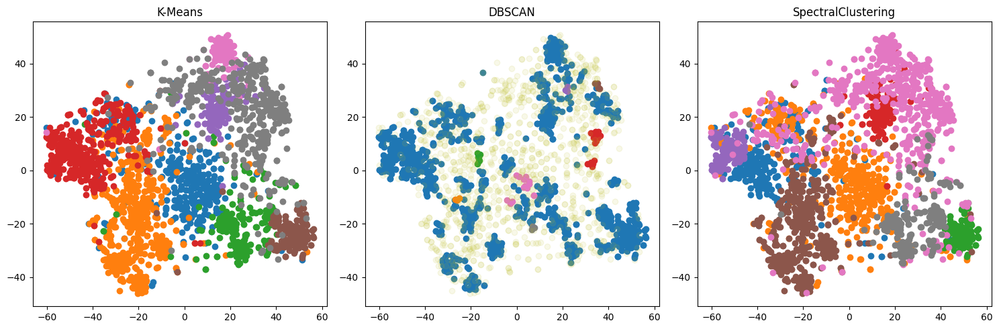

In [ ]:
import matplotlib.pyplot as plt

fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(15, 5))

for cluster in range(8):
    mask = kmeans.labels_ == cluster
    ax1.scatter(vec_texts_tsne[mask, 0], vec_texts_tsne[mask, 1])
    ax1.set_title('K-Means')

for cluster in range(8):
    mask = dbscan.labels_ == cluster
    ax2.scatter(vec_texts_tsne[mask, 0], vec_texts_tsne[mask, 1])
    ax2.set_title('DBSCAN')

noise_mask = dbscan.labels_ == -1
ax2.scatter(vec_texts_tsne[noise_mask, 0], vec_texts_tsne[noise_mask, 1], alpha = 0.1) # бледным цветом будут отмечены шумовые точки
ax2.set_title('DBSCAN')

for cluster in range(8):
    mask = spectral.labels_ == cluster
    ax3.scatter(vec_texts_tsne[mask, 0], vec_texts_tsne[mask, 1])
    ax3.set_title('SpectralClustering')

plt.tight_layout()
plt.show()

In [ ]:
from collections import Counter

label_counts = Counter(kmeans.labels_)
print('K-Means:')
for cluster_id, count in sorted(label_counts.items()):
    print(f"Кластер {cluster_id}: {round(count/len(kmeans.labels_)*100, 1)}% объектов")

K-Means:
Кластер 0: 15.8% объектов
Кластер 1: 22.7% объектов
Кластер 2: 9.2% объектов
Кластер 3: 16.7% объектов
Кластер 4: 6.1% объектов
Кластер 5: 7.1% объектов
Кластер 6: 4.1% объектов
Кластер 7: 18.3% объектов


In [ ]:
from collections import Counter

label_counts = Counter(dbscan.labels_)
print('DBSCAN:')
for cluster_id, count in sorted(label_counts.items()):
    print(f"Кластер {cluster_id}: {round(count/len(dbscan.labels_)*100, 1)}% объектов")

DBSCAN:
Кластер -1: 48.9% объектов
Кластер 0: 48.1% объектов
Кластер 1: 0.1% объектов
Кластер 2: 0.4% объектов
Кластер 3: 0.9% объектов
Кластер 4: 0.2% объектов
Кластер 5: 0.2% объектов
Кластер 6: 0.9% объектов
Кластер 7: 0.2% объектов


In [ ]:
from collections import Counter

label_counts = Counter(spectral.labels_)
print('SpectralClustering:')
for cluster_id, count in sorted(label_counts.items()):
    print(f"Кластер {cluster_id}: {round(count/len(spectral.labels_)*100, 1)}% объектов")

SpectralClustering:
Кластер 0: 10.3% объектов
Кластер 1: 19.2% объектов
Кластер 2: 5.1% объектов
Кластер 3: 5.3% объектов
Кластер 4: 5.5% объектов
Кластер 5: 19.8% объектов
Кластер 6: 25.5% объектов
Кластер 7: 9.2% объектов


Прокомментируйте получившиеся результаты. Какой баланс кластеров получился у разных методов? Соотносятся ли визуализации для текстов с визуализациями для географических данных?

**Ответ:** K-Means показал хорошие результаты: получившиеся кластеры расположены кучно, нет слишком большого или слишком маленького кластера.

DBSCAN с таким количеством кластеров сработал плохо: половина всех точек - это шум, а вторая половина практически полностью принадлежит одному кластеру, который сильно разбросан.

SpectralClustering показал достойные результаты: кластеры расположены довольно кучно, но шире, чем в K-Means, значит алгоритм лучше справляется с сложно разделимыми кластерами, баланс между кластерами нормальный.

Визуализация для текстов соотносится с визуализациями для географических данных, так как у K-Means получаются выпуклыее кластеры, практически без пересечений, DBSCAN находит кластеры сложной формы, однако в данном случае 8 кластеров оказалось неоптимальным количеством. SpectralClustering также находит пересекающиеся кластеры сложной формы, но работает стабильнее DBSCAN.

**Задание 2.4 (1.5 балла).** Обучите модель латентного размещения Дирихле. Не забудьте, что она работает с мешком слов, а не с tf-idf признаками. Придумайте, как превратить распределение тем для текста в номер его кластера. Возьмите параметр `n_components` в 2-3 раза больше, чем число кластеров для K-Means.

In [ ]:
from sklearn.decomposition import LatentDirichletAllocation
from sklearn.feature_extraction.text import CountVectorizer

count_vectorizer = CountVectorizer()
bag_of_words = count_vectorizer.fit_transform(data.text)

lda = LatentDirichletAllocation(n_components=16)
lda_preds = lda.fit_transform(bag_of_words)
lda_labels = lda_preds.argmax(axis=1)

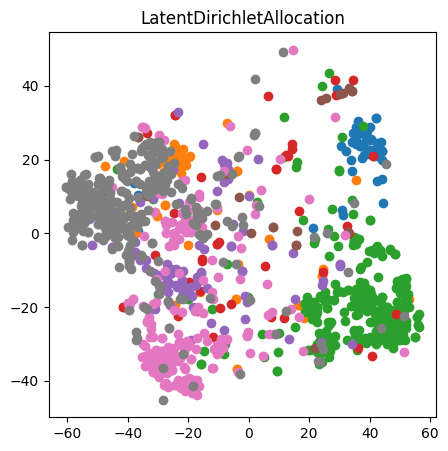

In [ ]:
fig, ax = plt.subplots(1, 1, figsize=(5, 5))

for cluster in range(8):
    mask = lda_labels == cluster
    ax.scatter(vec_texts_tsne[mask, 0], vec_texts_tsne[mask, 1])
    ax.set_title('LatentDirichletAllocation')

In [ ]:
vocab = count_vectorizer.get_feature_names_out()

for i, cluster in enumerate(lda.components_):
    indexes = np.argsort(cluster)
    print(f'cluster {i}: {vocab[indexes][::-1][:10]}')

cluster 0: ['open' 'lord' 'first' 'woman' 'australian' 'set' 'win' 'seed' 'match'
 'year']
cluster 1: ['law' 'police' 'lord' 'right' 'court' 'home' 'government' 'case' 'human'
 'mr']
cluster 2: ['film' 'best' 'award' 'year' 'music' 'show' 'star' 'also' 'one' 'actor']
cluster 3: ['would' 'ranger' 'year' 'one' 'two' 'time' 'new' 'game' 'sky' 'airline']
cluster 4: ['mr' 'company' 'firm' 'executive' 'would' 'share' 'chief' 'financial'
 'new' 'bid']
cluster 5: ['united' 'card' 'id' 'campbell' 'ferguson' 'home' 'used' 'first' 'would'
 'rooney']
cluster 6: ['year' 'economy' 'growth' 'market' 'rate' 'bank' 'economic' 'month'
 'china' 'price']
cluster 7: ['mr' 'would' 'labour' 'government' 'minister' 'blair' 'election' 'tory'
 'people' 'brown']
cluster 8: ['game' 'england' 'player' 'win' 'back' 'two' 'first' 'time' 'wale' 'last']
cluster 9: ['people' 'game' 'mobile' 'technology' 'phone' 'service' 'digital' 'music'
 'also' 'one']
cluster 10: ['party' 'ireland' 'scotland' 'lib' 'kennedy' 'vote' '

Получились ли темы более узкими от такого нововведения? Постройте облака тегов для нескольких наиболее удачных тем.

**Ответ:** Темы получились более узкими, так как большинство тем разделилось на две подтемы:

Ниже два кластера с темой "технологии", но второй можно назвать более узко: "кибербезопасность" или "защита компьютера".

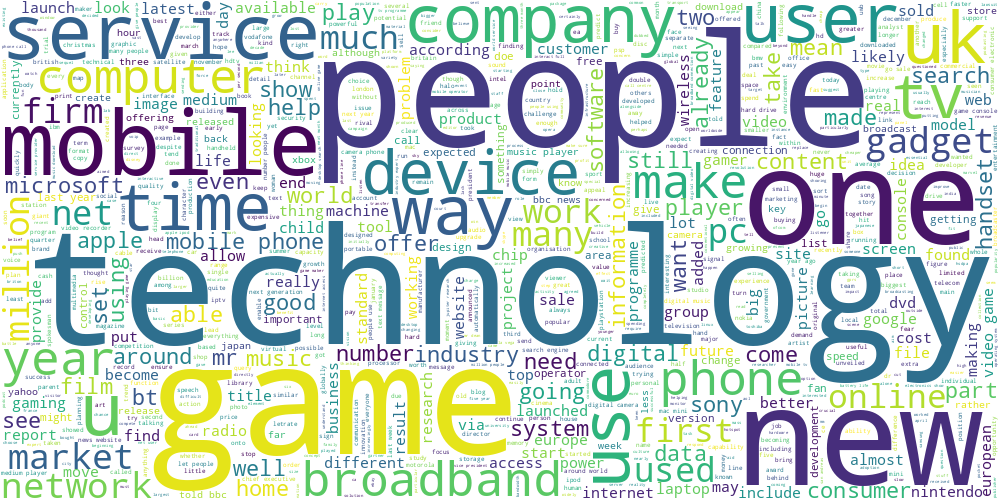

In [ ]:
draw_wordcloud(data[lda_labels == 9].text)

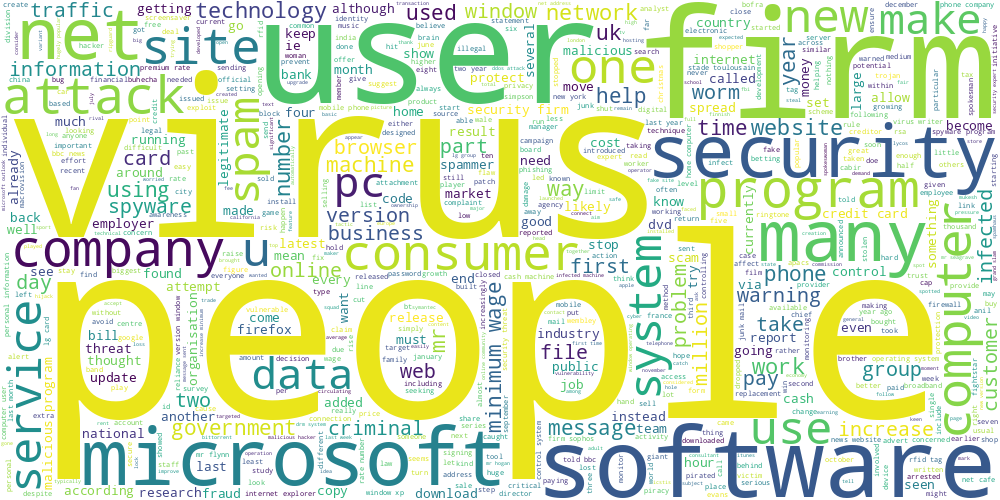

In [ ]:
draw_wordcloud(data[lda_labels == 13].text)

Ниже два кластера с темой "футбол", но второй можно назвать более узко: "футбольные болельщики".

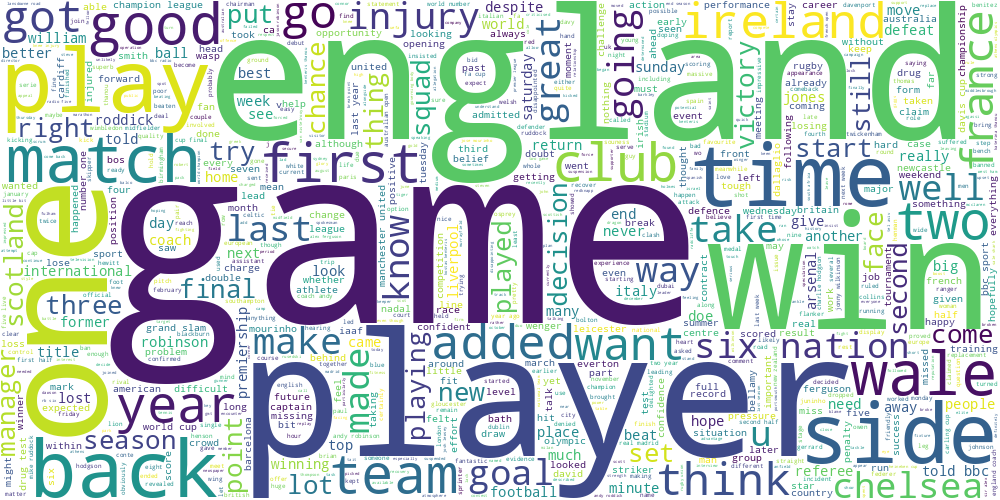

In [ ]:
draw_wordcloud(data[lda_labels == 8].text)

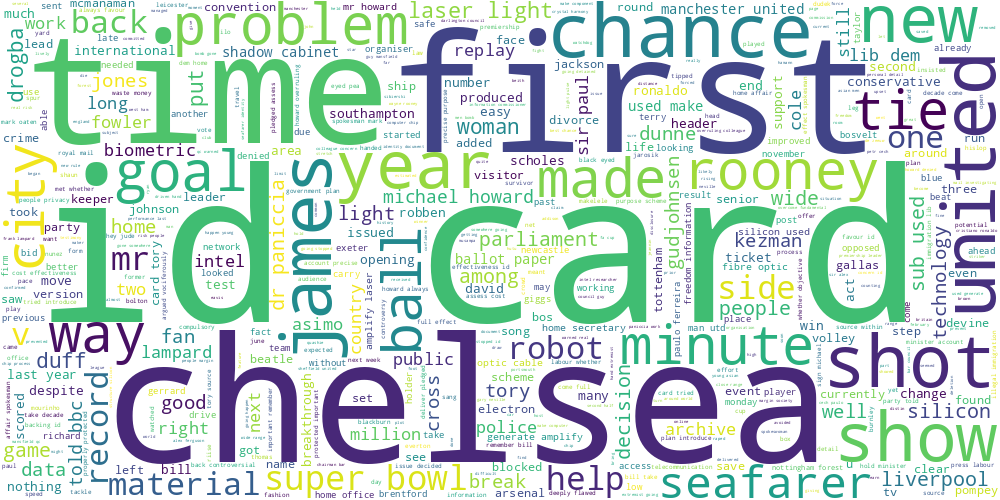

In [ ]:
draw_wordcloud(data[lda_labels == 5].text)

## Часть 3. Transfer learning и Self-Supervised Learning для задачи классификации текстов

**Задание 3.1 (0.5 балла).** Вспомним, что у нас есть разметка для тематик статей. Попробуем обучить классификатор поверх unsupervised-представлений для текстов. Рассмотрите три модели:

* Логистическая регрессия на tf-idf признаках
* K-Means на tf-idf признаках + логистическая регрессия на расстояниях до центров кластеров
* Латентное размещение Дирихле + логистическая регрессия на вероятностях тем

Разделите выборку на обучающую и тестовую, замерьте accuracy на обоих выборках для всех трех моделей. Параметры всех моделей возьмите равными значениям по умолчанию.

In [ ]:
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(data.text, data.category, test_size = 0.3)

In [ ]:
from sklearn.feature_extraction.text import TfidfVectorizer

vectorizer = TfidfVectorizer()
vec_X_train = vectorizer.fit_transform(X_train)
vec_X_test = vectorizer.transform(X_test)

In [ ]:
from sklearn.feature_extraction.text import CountVectorizer

count_vectorizer = CountVectorizer()
bag_X_train = count_vectorizer.fit_transform(X_train)
bag_X_test = count_vectorizer.transform(X_test)

In [ ]:
from sklearn.linear_model import LogisticRegression
from sklearn.cluster import KMeans
from sklearn.decomposition import LatentDirichletAllocation
from sklearn.metrics import accuracy_score

logreg = LogisticRegression()
logreg.fit(vec_X_train, y_train)
train_preds = logreg.predict(vec_X_train)
test_preds = logreg.predict(vec_X_test)

print('Accuracy на тренировчной выборке:', round(accuracy_score(train_preds, y_train), 3))
print('Accuracy на тестовой выборке:', round(accuracy_score(test_preds, y_test), 3))

Accuracy на тренировчной выборке: 0.998
Accuracy на тестовой выборке: 0.973


In [ ]:
kmeans = KMeans()
train_distances = kmeans.fit_transform(vec_X_train)
test_distances = kmeans.transform(vec_X_test)

logreg_kmeans = LogisticRegression()
logreg_kmeans.fit(train_distances, y_train)
train_preds_kmeans = logreg_kmeans.predict(train_distances)
test_preds_kmeans = logreg_kmeans.predict(test_distances)

print('Accuracy на тренировчной выборке:', round(accuracy_score(train_preds_kmeans , y_train), 3))
print('Accuracy на тестовой выборке:', round(accuracy_score(test_preds_kmeans, y_test), 3))

Accuracy на тренировчной выборке: 0.806
Accuracy на тестовой выборке: 0.801


In [ ]:
lda = LatentDirichletAllocation()
train_probs = lda.fit_transform(bag_X_train)
test_probs = lda.transform(bag_X_test)

logreg_lda = LogisticRegression()
logreg_lda.fit(train_probs, y_train)
train_preds_lda = logreg_lda.predict(train_probs)
test_preds_lda = logreg_lda.predict(test_probs)

print('Accuracy на тренировчной выборке:', round(accuracy_score(train_preds_lda , y_train), 3))
print('Accuracy на тестовой выборке:', round(accuracy_score(test_preds_lda, y_test), 3))

Accuracy на тренировчной выборке: 0.879
Accuracy на тестовой выборке: 0.931


У какой модели получилось лучшее качество? С чем это связано?

**Ответ:** Лучшее качество на обоих выборка получилось у модели логистической регрессии на tf-idf признаках. Это связано с тем, что параметры, используемые в алгоритмах кластеризации по умолчанию, неоптимальны и могут предполагать количество кластеров, отличное от количества классов, поэтому полученные расстояния и вероятности не отражают реальное разбиение текстов на темы.

**Задание 3.2 (1.5 балла).** Теперь просимулируем ситуацию слабой разметки, которая часто встречается в реальных данных. Разделим обучающую выборку в пропорции 5:65:30. Будем называть части, соответственно, размеченный трейн, неразмеченный трейн и валидация.

Все unsupervised-алгоритмы (векторайзеры и алгоритмы кластеризации) запускайте на всем трейне целиком (размеченном и неразмеченном, суммарно 70%), а итоговый классификатор обучайте только на размеченном трейне (5%). Подберите гиперпараметры моделей по качеству на валидации (30%), а затем оцените качество на тестовой выборке (которая осталась от прошлого задания). Не скромничайте при подборе числа кластеров, сейчас нас интересует не интерпретируемое разбиение выборки, а итоговое качество классификации.

In [ ]:
X_train_part, X_val, y_train_part, y_val = train_test_split(X_train, y_train, test_size = 0.3)

In [ ]:
X_train_unlabeled, X_train_labeled, y_train_unlabeled, y_train_labeled = train_test_split(X_train_part, y_train_part, test_size = 5/70)

In [ ]:
print(len(X_train_labeled), len(X_train_unlabeled), len(X_val))
sum = len(X_train_labeled) + len(X_train_unlabeled) + len(X_val)
print(f'{round(len(X_train_labeled)/sum*100, 1)}% {round(len(X_train_unlabeled)/sum*100, 1)}% {round(len(X_val)/sum*100, 1)}%')

78 1011 468
5.0% 64.9% 30.1%


In [ ]:
vectorizer = TfidfVectorizer()
vec_X_train_part = vectorizer.fit_transform(X_train_part)
vec_X_train_labeled = vectorizer.transform(X_train_labeled)
vec_X_train_unlabeled = vectorizer.transform(X_train_unlabeled)

vec_X_val = vectorizer.transform(X_val)
vec_X_test = vectorizer.transform(X_test)

In [ ]:
count_vectorizer = CountVectorizer()
bag_X_train_part = count_vectorizer.fit_transform(X_train_part)
bag_X_train_labeled = count_vectorizer.transform(X_train_labeled)
bag_X_train_unlabeled = count_vectorizer.transform(X_train_unlabeled)

bag_X_val = count_vectorizer.transform(X_val)
bag_X_test = count_vectorizer.transform(X_test)

In [ ]:
!pip install optuna

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 383.6/383.6 kB 11.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 231.9/231.9 kB 14.3 MB/s eta 0:00:00


In [ ]:
import optuna

def objective(trial):
    params = {
        'C': trial.suggest_float('C', 1e-4, 1e4, log=True),
        'solver': trial.suggest_categorical('solver', ['liblinear', 'lbfgs']),
        'max_iter': trial.suggest_int('max_iter', 100, 1000)
    }

    logreg = LogisticRegression(**params)
    logreg.fit(vec_X_train_labeled, y_train_labeled)
    val_preds = logreg.predict(vec_X_val)
    return accuracy_score(val_preds, y_val)

study = optuna.create_study(direction='maximize')
study.optimize(objective, n_trials=100)

best_params = study.best_params
print("Лучшие параметры:", best_params)

[I 2025-04-10 16:07:00,882] A new study created in memory with name: no-name-6ceba18c-fe27-4371-998e-7d123558a6c1
[I 2025-04-10 16:07:02,539] Trial 0 finished with value: 0.21367521367521367 and parameters: {'C': 0.00017335258299276424, 'solver': 'lbfgs', 'max_iter': 204}. Best is trial 0 with value: 0.21367521367521367.
[I 2025-04-10 16:07:02,660] Trial 1 finished with value: 0.844017094017094 and parameters: {'C': 6888.840438234535, 'solver': 'liblinear', 'max_iter': 970}. Best is trial 1 with value: 0.844017094017094.
[I 2025-04-10 16:07:02,846] Trial 2 finished with value: 0.8397435897435898 and parameters: {'C': 2651.0844191484935, 'solver': 'liblinear', 'max_iter': 324}. Best is trial 1 with value: 0.844017094017094.
[I 2025-04-10 16:07:03,016] Trial 3 finished with value: 0.8397435897435898 and parameters: {'C': 4705.235358354238, 'solver': 'liblinear', 'max_iter': 455}. Best is trial 1 with value: 0.844017094017094.
[I 2025-04-10 16:07:04,672] Trial 4 finished with value: 0.213

Лучшие параметры: {'C': 9779.193183122667, 'solver': 'liblinear', 'max_iter': 113}


In [ ]:
logreg = LogisticRegression(**best_params)
logreg.fit(vec_X_train_labeled, y_train_labeled)
test_preds = logreg.predict(vec_X_test)
print('Accuracy на тестовой выборке:', round(accuracy_score(test_preds, y_test), 3))

Accuracy на тестовой выборке: 0.859


In [ ]:
def objective(trial):
    params_logreg = {
        'C': trial.suggest_float('C', 1e-4, 1e4, log=True),
        'solver': trial.suggest_categorical('solver', ['liblinear', 'lbfgs']),
        'max_iter': trial.suggest_int('max_iter', 100, 3000)
    }

    params_kmeans = {
        'n_clusters': trial.suggest_int('n_clusters', 2, 70),
        'init': trial.suggest_categorical('init', ['k-means++', 'random']),
        'n_init': trial.suggest_int('n_init', 5, 20)
    }

    kmeans = KMeans(**params_kmeans)
    train_labeled_distances = kmeans.fit_transform(vec_X_train_labeled)
    val_distances = kmeans.transform(vec_X_val)

    logreg_kmeans = LogisticRegression(**params_logreg)
    logreg_kmeans.fit(train_labeled_distances, y_train_labeled)
    val_preds_kmeans = logreg_kmeans.predict(val_distances)
    return accuracy_score(val_preds_kmeans, y_val)

study = optuna.create_study(direction='maximize')
study.optimize(objective, n_trials=100)

best_params = study.best_params
print("Лучшие параметры:", best_params)

[I 2025-04-10 16:28:05,259] A new study created in memory with name: no-name-0c000c36-fb0c-4dd8-96b8-e4e422bd028d
[I 2025-04-10 16:28:05,628] Trial 0 finished with value: 0.21367521367521367 and parameters: {'C': 0.2184036233652173, 'solver': 'lbfgs', 'max_iter': 669, 'n_clusters': 57, 'init': 'random', 'n_init': 6}. Best is trial 0 with value: 0.21367521367521367.
[I 2025-04-10 16:28:07,739] Trial 1 finished with value: 0.5235042735042735 and parameters: {'C': 2.8327913016409063, 'solver': 'lbfgs', 'max_iter': 1806, 'n_clusters': 64, 'init': 'k-means++', 'n_init': 20}. Best is trial 1 with value: 0.5235042735042735.
[I 2025-04-10 16:28:07,975] Trial 2 finished with value: 0.21367521367521367 and parameters: {'C': 0.0004579227958988267, 'solver': 'lbfgs', 'max_iter': 2834, 'n_clusters': 26, 'init': 'k-means++', 'n_init': 5}. Best is trial 1 with value: 0.5235042735042735.
[I 2025-04-10 16:28:08,306] Trial 3 finished with value: 0.7799145299145299 and parameters: {'C': 4359.748063489027

Лучшие параметры: {'C': 1940.0743753922081, 'solver': 'liblinear', 'max_iter': 2691, 'n_clusters': 40, 'init': 'random', 'n_init': 9}


In [ ]:
kmeans = KMeans(n_clusters=best_params['n_clusters'], init=best_params['init'], n_init=best_params['n_init'])
train_labeled_distances = kmeans.fit_transform(vec_X_train_labeled)
test_distances = kmeans.transform(vec_X_test)

logreg_kmeans = LogisticRegression(C=best_params['C'], solver=best_params['solver'], max_iter=best_params['max_iter'])
logreg_kmeans.fit(train_labeled_distances, y_train_labeled)
test_preds_kmeans = logreg_kmeans.predict(test_distances)
print('Accuracy на тестовой выборке:', round(accuracy_score(test_preds_kmeans, y_test), 3))

Accuracy на тестовой выборке: 0.868


In [ ]:
def objective(trial):
    params_logreg = {
        'C': trial.suggest_float('C', 1e-4, 1e4, log=True),
        'solver': trial.suggest_categorical('solver', ['liblinear', 'lbfgs']),
        'max_iter': trial.suggest_int('max_iter', 100, 3000)
    }

    params_lda = {
        'n_components': trial.suggest_int('n_components', 2, 70),
        'learning_decay': trial.suggest_float('learning_decay', 0.5, 1.0),
        'doc_topic_prior': trial.suggest_float('doc_topic_prior', 0.01, 1.0)
    }

    lda = LatentDirichletAllocation(**params_lda)
    train_labeled_probs = lda.fit_transform(bag_X_train_labeled)
    val_probs = lda.transform(bag_X_val)

    logreg_lda = LogisticRegression(**params_logreg)
    logreg_lda.fit(train_labeled_probs, y_train_labeled)
    val_preds_lda = logreg_lda.predict(val_probs)
    return accuracy_score(val_preds_lda, y_val)

study = optuna.create_study(direction='maximize')
study.optimize(objective, n_trials=100)

best_params = study.best_params
print("Лучшие параметры:", best_params)

[I 2025-04-10 16:38:09,576] A new study created in memory with name: no-name-443f1b1f-dd58-43f0-875e-f62864ed6f46
[I 2025-04-10 16:38:10,432] Trial 0 finished with value: 0.21367521367521367 and parameters: {'C': 0.024065461219641916, 'solver': 'lbfgs', 'max_iter': 1100, 'n_components': 30, 'learning_decay': 0.5566971465397578, 'doc_topic_prior': 0.7091540363494384}. Best is trial 0 with value: 0.21367521367521367.
[I 2025-04-10 16:38:11,176] Trial 1 finished with value: 0.37393162393162394 and parameters: {'C': 0.9464085863038815, 'solver': 'lbfgs', 'max_iter': 122, 'n_components': 24, 'learning_decay': 0.8573490195207676, 'doc_topic_prior': 0.5970788893570498}. Best is trial 1 with value: 0.37393162393162394.
[I 2025-04-10 16:38:11,636] Trial 2 finished with value: 0.21367521367521367 and parameters: {'C': 0.16277547542948165, 'solver': 'liblinear', 'max_iter': 2943, 'n_components': 3, 'learning_decay': 0.9292225979541526, 'doc_topic_prior': 0.25248294114953324}. Best is trial 1 with

Лучшие параметры: {'C': 154.3256256340385, 'solver': 'liblinear', 'max_iter': 2855, 'n_components': 64, 'learning_decay': 0.846228246784529, 'doc_topic_prior': 0.05593742165148871}


In [ ]:
lda = LatentDirichletAllocation(n_components=best_params['n_components'], learning_decay=best_params['learning_decay'], doc_topic_prior=best_params['doc_topic_prior'])
train_labeled_probs = lda.fit_transform(bag_X_train_labeled)
test_probs = lda.transform(bag_X_test)

logreg_lda = LogisticRegression(C=best_params['C'], solver=best_params['solver'], max_iter=best_params['max_iter'])
logreg_lda.fit(train_labeled_probs, y_train_labeled)
test_preds_lda = logreg_lda.predict(test_probs)
print('Accuracy на тестовой выборке:', round(accuracy_score(test_preds_lda, y_test), 3))

Accuracy на тестовой выборке: 0.877


Как изменились результаты по сравнению с обучением на полной разметке? Сделайте выводы.

**Ответ:** Качество не тестовой выборке упало у первой и третьей модели (я думаю упало бы и на второй, если бы в прошлом задании для этой модели были бы подобраны оптимальные гиперпараметры), что логично, так как теперь у нас размечено только 5% выборки, но стоит заметить, что наибольше падение качество наблюдается у первой модели логистической регрессии, а остальные модели (с кластеризацией) показывают качество чуть лучше. Из этого можно сделать вывод, что модели с кластеризацией отлично подходят для задач с ситуацией слабой разметки.

## Бонус

**Задание 4 (0.5 балла)**. Разберитесь с semi-supervised методами, которые реализованы в `sklearn` и примените их к заданию 3.2. Получилось ли добиться лучшего качества? Сделайте выводы.

In [ ]:
from sklearn.semi_supervised import SelfTrainingClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score

def objective(trial):
    params_logreg = {
        'C': trial.suggest_float('C', 1e-4, 1e4, log=True),
        'solver': trial.suggest_categorical('solver', ['liblinear', 'lbfgs']),
        'max_iter': trial.suggest_int('max_iter', 100, 3000)
    }

    params_self_training = {
        'threshold': trial.suggest_float('threshold', 0.5, 0.99)
    }

    logreg_self = LogisticRegression(**params_logreg)

    self_training = SelfTrainingClassifier(logreg_self, **params_self_training)
    self_training.fit(vec_X_train_semi, y_train_semi)
    val_preds_self = self_training.predict(vec_X_val)

    return accuracy_score(val_preds_self, y_val)

X_train_semi = pd.concat([X_train_labeled, X_train_unlabeled], axis=0)
vec_X_train_semi = vectorizer.transform(X_train_semi)
y_train_semi = np.hstack([y_train_labeled, -np.ones(len(X_train_unlabeled))])

study = optuna.create_study(direction='maximize')
study.optimize(objective, n_trials=100)

best_params = study.best_params
print("Лучшие параметры:", best_params)

[I 2025-04-10 17:17:25,812] A new study created in memory with name: no-name-c387249b-e65e-4196-8669-34a85a675671
[I 2025-04-10 17:17:26,876] Trial 0 finished with value: 0.21367521367521367 and parameters: {'C': 0.0005908680919571812, 'solver': 'lbfgs', 'max_iter': 597, 'threshold': 0.8331129212868098}. Best is trial 0 with value: 0.21367521367521367.
[I 2025-04-10 17:17:27,895] Trial 1 finished with value: 0.21367521367521367 and parameters: {'C': 0.0008169398572003486, 'solver': 'lbfgs', 'max_iter': 2189, 'threshold': 0.6357816692726868}. Best is trial 0 with value: 0.21367521367521367.
[I 2025-04-10 17:17:27,966] Trial 2 finished with value: 0.21367521367521367 and parameters: {'C': 0.20870548167206937, 'solver': 'liblinear', 'max_iter': 1026, 'threshold': 0.7725033331892865}. Best is trial 0 with value: 0.21367521367521367.
[I 2025-04-10 17:17:28,031] Trial 3 finished with value: 0.5170940170940171 and parameters: {'C': 1.6230416816912645, 'solver': 'liblinear', 'max_iter': 2474, 

Лучшие параметры: {'C': 5444.60970780051, 'solver': 'liblinear', 'max_iter': 269, 'threshold': 0.840472487749492}


In [ ]:
logreg_self = LogisticRegression(C=best_params['C'], solver=best_params['solver'], max_iter=best_params['max_iter'])

self_training = SelfTrainingClassifier(logreg_self, threshold=best_params['threshold'])
self_training.fit(vec_X_train_semi, y_train_semi)
test_preds_self = self_training.predict(vec_X_test)

print('Accuracy на тестовой выборке:', round(accuracy_score(test_preds_self, y_test), 3))

Accuracy на тестовой выборке: 0.942


In [ ]:
from sklearn.preprocessing import LabelEncoder

label_encoder = LabelEncoder()
y_train_part_encoded = label_encoder.fit_transform(y_train_part)
y_train_labeled_encoded = label_encoder.transform(y_train_labeled)

y_val_encoded = label_encoder.transform(y_val)
y_test_encoded = label_encoder.transform(y_test)

y_train_semi_encoded = np.hstack([y_train_labeled_encoded, -np.ones(len(X_train_unlabeled))])

In [ ]:
import warnings
from sklearn.exceptions import ConvergenceWarning

warnings.filterwarnings('ignore', category=ConvergenceWarning)
warnings.filterwarnings('ignore', category=RuntimeWarning)

In [ ]:
from sklearn.semi_supervised import LabelPropagation

def objective(trial):
    params_label_prop = {
        'kernel': trial.suggest_categorical('kernel', ['knn', 'rbf']),
        'gamma': trial.suggest_float('gamma', 0.01, 10, log=True),
        'n_neighbors': trial.suggest_int('n_neighbors', 3, 15),
        'max_iter': trial.suggest_int('max_iter', 2500, 3000),
        'tol': trial.suggest_float('tol', 1e-5, 1e-2, log=True)
    }

    label_prop = LabelPropagation(**params_label_prop)
    label_prop.fit(vec_X_train_semi, y_train_semi_encoded)
    val_preds_label = label_prop.predict(vec_X_val)

    return accuracy_score(val_preds_label, y_val_encoded)

study = optuna.create_study(direction='maximize')
study.optimize(objective, n_trials=100)

best_params = study.best_params
print("Лучшие параметры:", best_params)

[I 2025-04-10 17:30:59,419] A new study created in memory with name: no-name-aa70bd57-b200-4597-a054-d0dacc15e0b5
[I 2025-04-10 17:31:04,146] Trial 0 finished with value: 0.24786324786324787 and parameters: {'kernel': 'rbf', 'gamma': 5.441343673564586, 'n_neighbors': 8, 'max_iter': 2982, 'tol': 0.0014129166838203933}. Best is trial 0 with value: 0.24786324786324787.
[I 2025-04-10 17:31:04,402] Trial 1 finished with value: 0.8098290598290598 and parameters: {'kernel': 'knn', 'gamma': 0.4680027197134892, 'n_neighbors': 15, 'max_iter': 2752, 'tol': 0.00023086070716617544}. Best is trial 1 with value: 0.8098290598290598.
[I 2025-04-10 17:31:04,573] Trial 2 finished with value: 0.21367521367521367 and parameters: {'kernel': 'rbf', 'gamma': 0.07109608973372354, 'n_neighbors': 15, 'max_iter': 2656, 'tol': 0.0032673509140086457}. Best is trial 1 with value: 0.8098290598290598.
[I 2025-04-10 17:31:04,848] Trial 3 finished with value: 0.7905982905982906 and parameters: {'kernel': 'knn', 'gamma':

Лучшие параметры: {'kernel': 'knn', 'gamma': 0.6979004786393357, 'n_neighbors': 8, 'max_iter': 2843, 'tol': 2.3797537120467016e-05}


In [ ]:
label_prop = LabelPropagation(**best_params)
label_prop.fit(vec_X_train_semi, y_train_semi_encoded)
test_preds_label_prop = label_prop.predict(vec_X_test)

print('Accuracy на тестовой выборке:', round(accuracy_score(test_preds_label_prop, y_test_encoded), 3))

Accuracy на тестовой выборке: 0.847


In [ ]:
from sklearn.semi_supervised import LabelSpreading

def objective(trial):
    params_label_spread = {
        'kernel': trial.suggest_categorical('kernel', ['knn', 'rbf']),
        'gamma': trial.suggest_float('gamma', 0.01, 10, log=True),
        'n_neighbors': trial.suggest_int('n_neighbors', 3, 15),
        'alpha': trial.suggest_float('alpha', 0.1, 0.9),
        'max_iter': trial.suggest_int('max_iter', 2500, 3000),
        'tol': trial.suggest_float('tol', 1e-5, 1e-2, log=True)
    }

    label_spread = LabelSpreading(**params_label_spread)
    label_spread.fit(vec_X_train_semi, y_train_semi_encoded)
    val_preds_label = label_spread.predict(vec_X_val)

    return accuracy_score(val_preds_label, y_val_encoded)

study = optuna.create_study(direction='maximize')
study.optimize(objective, n_trials=100)

best_params = study.best_params
print("Лучшие параметры:", best_params)

[I 2025-04-10 17:30:21,082] A new study created in memory with name: no-name-9cb97acd-a68a-4546-ac5e-5d31d02b19b1
[I 2025-04-10 17:30:21,261] Trial 0 finished with value: 0.9081196581196581 and parameters: {'kernel': 'knn', 'gamma': 0.013710807091902186, 'n_neighbors': 15, 'alpha': 0.8320902385278499, 'max_iter': 2709, 'tol': 5.26457338654606e-05}. Best is trial 0 with value: 0.9081196581196581.
[I 2025-04-10 17:30:21,446] Trial 1 finished with value: 0.21367521367521367 and parameters: {'kernel': 'rbf', 'gamma': 0.06849041283208819, 'n_neighbors': 10, 'alpha': 0.5561496662705887, 'max_iter': 2653, 'tol': 0.00014150814543529192}. Best is trial 0 with value: 0.9081196581196581.
[I 2025-04-10 17:30:21,656] Trial 2 finished with value: 0.21367521367521367 and parameters: {'kernel': 'rbf', 'gamma': 0.25773232109727895, 'n_neighbors': 13, 'alpha': 0.28467219900108304, 'max_iter': 2913, 'tol': 1.933157542423595e-05}. Best is trial 0 with value: 0.9081196581196581.
[I 2025-04-10 17:30:21,845]

Лучшие параметры: {'kernel': 'knn', 'gamma': 0.6056819410036465, 'n_neighbors': 14, 'alpha': 0.31635158572150024, 'max_iter': 2969, 'tol': 0.005457602764050797}


In [ ]:
label_spread = LabelSpreading(**best_params)
label_spread.fit(vec_X_train_semi, y_train_semi_encoded)
test_preds_label_spread = label_spread.predict(vec_X_test)

print('Accuracy на тестовой выборке:', round(accuracy_score(test_preds_label_spread, y_test_encoded), 3))

Accuracy на тестовой выборке: 0.894


**Вывод:** Модели SelfTrainingClassifier и LabelSpreading показали качество значительно выше, чем модели из предыдущего задания (наибольший прирост 6.5%). LabelSpreading очень похож на LabelPropagation, однако выдает качество лучше, что скорее всего связано с дополнительным гиперпараметром alpha. Таким образом, можно сделать вывод, что данные модели отлично подходят для задач с ситуацией слабой разметки, для чего они и созданы, так как могут учитывать неразмеченные объекты (им присваивается y = -1).

**Задание 5 (1 балл).** На занятиях мы обсуждали, что метрика BCubed хорошо подходит для сравнения алгоритмов кластеризации, если нам известно настоящее разделение на кластеры (gold standard). Реализуйте подсчет метрики BCubed и сравните несколько алгоритмов кластеризации на текстовых данных из основного задания. В качестве gold standard используйте разметку category.

In [ ]:
def BCubed(pred_labels, true_labels):
    n = len(true_labels)
    Сorrectness = np.zeros((n, n), dtype=bool)

    # создаем матрицу Сorrectness
    for i in range(n):
        for j in range(n):
            Сorrectness[i,j] = (pred_labels[i] == pred_labels[j])*(true_labels[i] == true_labels[j])

    # вычисляем precision и recall для каждого элемента
    precisions = []
    recalls = []

    for i in range(n):
        cluster_mask = (pred_labels == pred_labels[i]) # элементы в том же кластере
        category_mask = (true_labels == true_labels[i]) # элементы в той же категории

        precision = np.mean(Сorrectness[i, cluster_mask])
        precisions.append(precision)

        recall = np.mean(Сorrectness[i, category_mask])
        recalls.append(recall)

    # усредняем по всем элементам
    avg_precision = np.mean(precisions)
    avg_recall = np.mean(recalls)

    # вычисляем F-меру
    if avg_precision + avg_recall == 0:
        F = 0
    else:
        F = 2*(avg_precision*avg_recall)/(avg_precision + avg_recall)

    return {'Precision-BCubed': round(float(avg_precision), 3), 'Recall-BCubed': round(float(avg_recall), 3), 'BCubed': round(float(F), 3)}

In [ ]:
BCubed(test_preds, np.array(y_test))

{'Precision-BCubed': 0.765, 'Recall-BCubed': 0.762, 'BCubed': 0.763}

In [ ]:
BCubed(test_preds_kmeans, np.array(y_test))

{'Precision-BCubed': 0.775, 'Recall-BCubed': 0.78, 'BCubed': 0.778}

In [ ]:
BCubed(test_preds_lda, np.array(y_test))

{'Precision-BCubed': 0.779, 'Recall-BCubed': 0.781, 'BCubed': 0.78}

**Вывод:** После подсчета метрики BCubed для моделей из задания 3.2 мы видим, что наилучшей является третья модель (это мы также получили, сравнивая accuracy), и метрики для трех моделей очень близки, что также не противоречит близким значениям accuracy, полученным в задании 3.2.

**Задание 6 (2 баллa)**. Спектральная кластеризация, по сути, является обычной кластеризацией KMeans поверх эмбеддингов объектов, которые получаются из лапласиана графа. А что, если мы попробуем построить эмбеддинги каким-нибудь другим способом? В этом задании мы предлагаем вам проявить немного фантазии. Возьмите какие-нибудь данные высокой размерности, чтобы задача обучения эмбеддингов имела смысл (например, картинки или тексты, желательно выбрать что-нибудь оригинальное). Придумайте или найдите какой-нибудь метод обучения эмбеддингов, примените его к данным и кластеризуйте полученные представления. Если чувствуете в себе достаточно силы, можете попробовать что-нибудь нейросетевое. Сравните ваш подход с базовыми алгоритмами кластеризации, которое мы рассмотрели в основном задании, не забывайте про визуализации! Ключевые слова для вдохновения: ***KernelPCA***, ***UMAP***, ***autoencoders***, ***gensim***.

Протестируем алгоритм UMAP для получения эмбеддингов на датасете MNIST:

In [2]:
from sklearn.datasets import fetch_openml

mnist = fetch_openml('mnist_784', version=1)
X, y = mnist.data.values, mnist.target.astype(int)

X = X/255.0
X_sample = X[:10000]
y_sample = y[:10000]

In [3]:
import warnings
warnings.filterwarnings("ignore", category=FutureWarning)
warnings.filterwarnings("ignore", category=UserWarning)

In [4]:
from umap import UMAP
from sklearn.metrics import adjusted_rand_score

umap = UMAP(n_components=20)
X_umap = umap.fit_transform(X_sample)

Будем использовать метрику Adjusted Rand Index (ARI), которая измеряет сходство между двумя разбиениями данных, учитывая случайные совпадения и не учитывая порядок кластеров.

In [12]:
kmeans = KMeans(n_clusters=10)
labels_umap = kmeans.fit_predict(X_umap)

ARI = adjusted_rand_score(labels_umap, y_sample)
print('Adjusted Rand Index:', round(ARI, 3))

Adjusted Rand Index: 0.736


Сравним с базовыми алгоритмами кластеризации из основного задания:

In [13]:
kmeans = KMeans(n_clusters=10)
labels_kmeans = kmeans.fit_predict(X_sample)

ARI = adjusted_rand_score(labels_kmeans, y_sample)
print('Adjusted Rand Index:', round(ARI, 3))

Adjusted Rand Index: 0.401


In [ ]:
# подбираем eps при котором будет 10 кластеров у DBSCAN
for eps in np.linspace(1.5, 2.5, 20):
    dbscan = DBSCAN(eps = eps).fit(X_sample)
    if -1 in dbscan.labels_:
        n_clusters = len(np.unique(dbscan.labels_)) - 1
    else:
        n_clusters = len(np.unique(dbscan.labels_))

    print(f'eps: {round(eps, 2)}, n_clusters: {n_clusters}')

eps: 1.5, n_clusters: 2
eps: 1.55, n_clusters: 2
eps: 1.61, n_clusters: 5
eps: 1.66, n_clusters: 7
eps: 1.71, n_clusters: 7
eps: 1.76, n_clusters: 9
eps: 1.82, n_clusters: 9
eps: 1.87, n_clusters: 10
eps: 1.92, n_clusters: 15
eps: 1.97, n_clusters: 17
eps: 2.03, n_clusters: 12
eps: 2.08, n_clusters: 12
eps: 2.13, n_clusters: 16
eps: 2.18, n_clusters: 13
eps: 2.24, n_clusters: 8
eps: 2.29, n_clusters: 5
eps: 2.34, n_clusters: 3
eps: 2.39, n_clusters: 4
eps: 2.45, n_clusters: 4
eps: 2.5, n_clusters: 2


In [30]:
dbscan = DBSCAN(eps=1.87)
labels_dbscan = dbscan.fit_predict(X_sample)

ARI = adjusted_rand_score(labels_dbscan, y_sample)
print('Adjusted Rand Index:', round(ARI, 3))

Adjusted Rand Index: -0.0


DBSCAN определил практически все точки в шумовые, так что не будем использовать эту модель.

In [22]:
spectral = SpectralClustering(n_clusters=10)
labels_spectral = spectral.fit_predict(X_sample[:1000])

ARI = adjusted_rand_score(labels_spectral, y_sample[:1000])
print('Adjusted Rand Index:', round(ARI, 3))

Adjusted Rand Index: 0.0


SpectralClustering определил все точки в нулевой класс, так что эту модель также не будем использовать.

In [15]:
lda = LatentDirichletAllocation(n_components=10)
preds_lda = lda.fit_transform(X_sample)
labels_lda = preds_lda.argmax(axis=1)

ARI = adjusted_rand_score(labels_lda, y_sample)
print('Adjusted Rand Index:', round(ARI, 3))

Adjusted Rand Index: 0.293


In [19]:
from sklearn.manifold import TSNE
X_tsne = TSNE(n_components=2).fit_transform(X_sample)
X_umap_tsne = TSNE(n_components=2).fit_transform(X_umap)

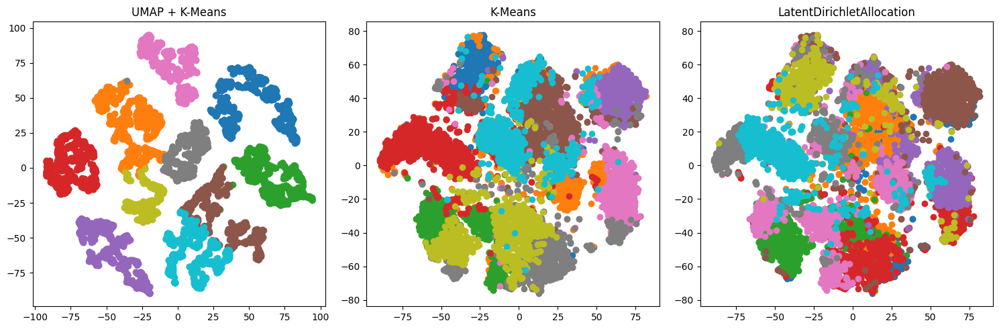

In [21]:
import matplotlib.pyplot as plt

fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(15, 5))

for cluster in range(10):
    mask = labels_umap == cluster
    ax1.scatter(X_umap_tsne[mask, 0], X_umap_tsne[mask, 1])
    ax1.set_title('UMAP + K-Means')

for cluster in range(10):
    mask = labels_kmeans == cluster
    ax2.scatter(X_tsne[mask, 0], X_tsne[mask, 1])
    ax2.set_title('K-Means')

for cluster in range(10):
    mask = labels_lda == cluster
    ax3.scatter(X_tsne[mask, 0], X_tsne[mask, 1])
    ax3.set_title('LatentDirichletAllocation')

plt.tight_layout()
plt.show()

**Вывод:** Можно заметить, что полученные с помощью UMAP эмбеддинги отлично кластеризуются и показывают наилучшее качество (если использовать всю выборку, то ARI будет больше 0,9). Стандартные модели либо работают нестабильно (DBSCAN, SpectralClustering), либо показывают качество в два раза хуже (K-Means, LDA).

**Задание 7 (1 балл)**. Наконец, ставший ежегодной традицией социализационный бонус. Мы поощряем не только предметное, но и духовное развитие. Поэтому, чтобы заработать балл за это задание, сходите на какую-нибудь выставку, в музей, театр, или наконец в церковь, напишите небольшой отчетик о ваших впечатлениях и добавьте фотопруфы в ноутбук при сдаче. Можете объединиться с одногруппниками/однокурсниками, а также пригласить ассистентов/преподавателей, они тоже будут рады выбраться куда-нибудь. Для вдохновения приведем ссылку на актуальные выставки [новой](https://www.youtube.com/watch?v=dQw4w9WgXcQ&ab) и [старой Третьяковки](https://www.youtube.com/watch?v=xm3YgoEiEDc) (но совсем не обязательно посещать именно их).

**Локация:** Главный храм Вооруженных Сил России + музейный комплекс "Дорога памяти"

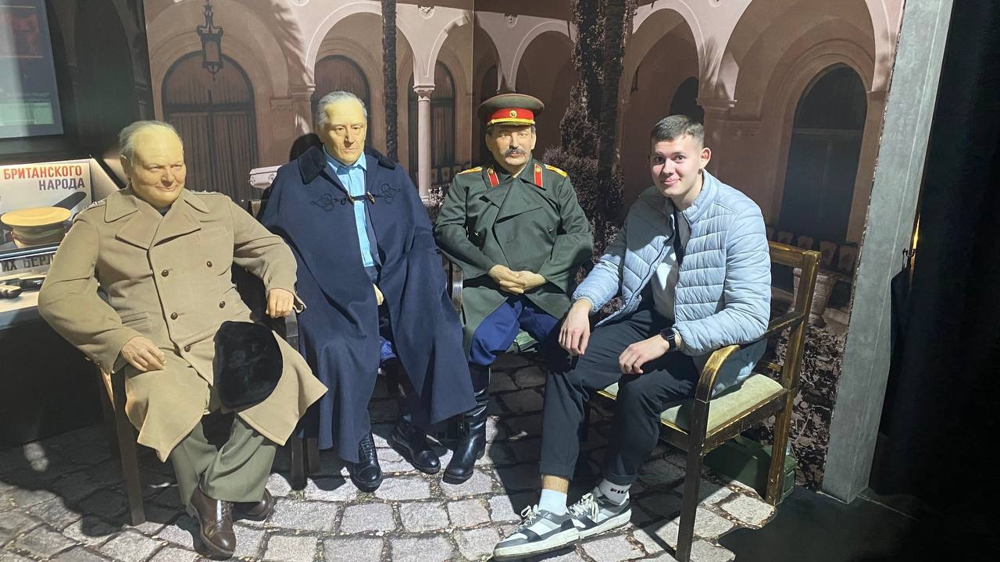

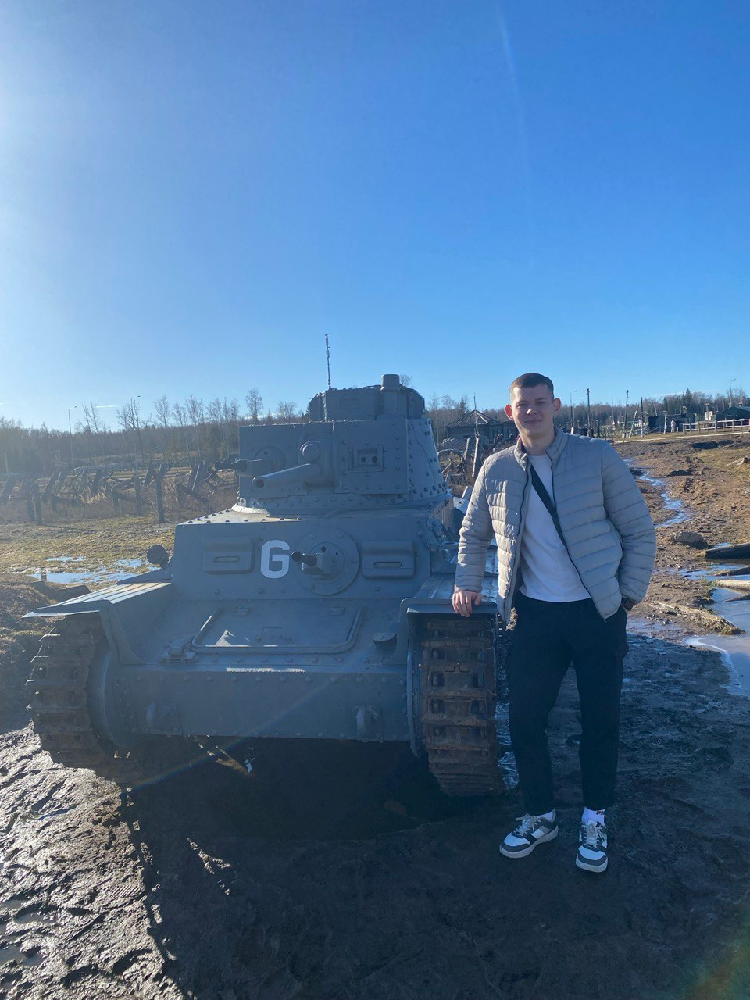

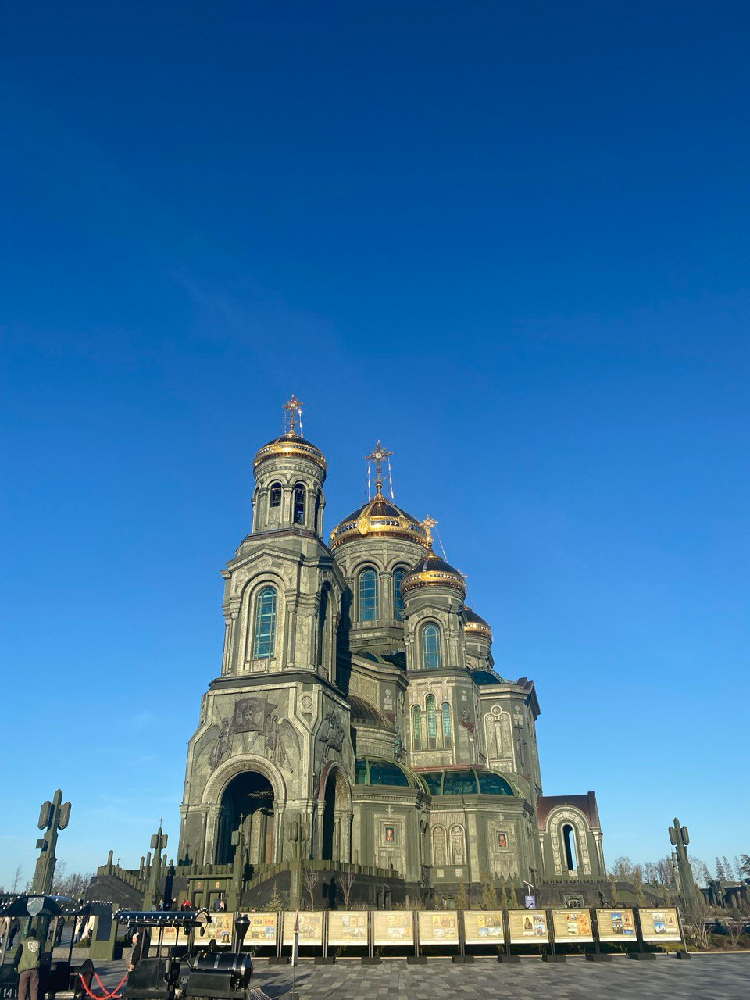